## User Embeddings using BERT

In [1]:
!pip install transformers


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: pip install --upgrade pip


In [2]:
!pip install torch


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: pip install --upgrade pip


In [3]:
from transformers import BertModel, BertTokenizer
import torch

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# Example text data
text = "This is an example of user-generated content."
inputs = tokenizer(text, return_tensors='pt')
outputs = model(**inputs)

# Get the embeddings
user_embeddings = outputs.last_hidden_state.mean(dim=1)
print("User Embeddings:\n", user_embeddings)

/Users/metildachee/.pyenv/versions/3.11.6/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/Users/metildachee/.pyenv/versions/3.11.6/lib/python3.11/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


User Embeddings:
 tensor([[ 7.8387e-02, -1.4728e-01, -1.8703e-01, -3.7683e-01, -1.9916e-01,
         -8.4584e-01,  1.9591e-01,  5.5392e-01, -1.1710e-01,  1.5647e-01,
         -3.3094e-01, -5.7700e-01, -4.1666e-01,  5.2069e-01, -3.3001e-01,
          1.0874e-01, -3.5537e-01,  8.9011e-02, -1.1539e-01, -2.8359e-01,
          4.4308e-02,  2.9429e-01, -5.3615e-01,  2.1277e-01,  9.1649e-01,
         -4.0149e-01,  1.2532e-01, -2.1923e-01, -6.3659e-01,  4.9854e-02,
          4.0099e-01,  1.7010e-01, -5.6581e-02,  3.0574e-02, -1.8203e-01,
         -4.0248e-01,  2.3128e-01, -1.9321e-01, -2.7533e-01,  1.6998e-01,
         -5.1509e-01, -4.3055e-01,  6.2838e-01,  5.9137e-01,  1.8789e-01,
         -8.3266e-02,  4.4637e-01,  2.0469e-01,  1.0236e-01, -1.7634e-01,
         -1.2758e+00,  3.0343e-01,  6.7654e-02,  3.6445e-01,  1.2374e-01,
          4.8366e-01,  1.5553e-01, -8.7175e-01, -2.6595e-01,  2.6137e-02,
          3.7322e-01,  2.5816e-01,  1.9417e-02, -7.9785e-01,  2.7292e-01,
          1.8664e-01

### User Embeddings using MLP
1. Get all the embeddings of the images that the user likes
2. Get the mean embeddings of the images that the user likes (include last+exclude last)

In [23]:
import json

def get_user_to_images(path, num_users):
    users = []
    if num_users != -1:
        num_users -= 1
    with open(path, 'r') as file:
        for line in file:
            data = json.loads(line)
            
            oid = data.get('_id', '').get('$oid', '')
            pins = data.get('pins', [])
            users.append({ "pins": pins, "oid": oid })
            if num_users == -1:
                continue
            if len(users) > num_users:
                break
    return users

In [21]:
path = "../../data/pinterest/board_to_pins.json"
num_users = -1
user_to_images = get_user_to_images(path, num_users)

In [33]:
print(len(user_to_images))

user_to_images[0]

46000


{'pins': ['119134352618674646',
  '119134352618662252',
  '119134352618656367',
  '119134352618650870',
  '119134352618446617',
  '119134352618440692',
  '119134352618427540',
  '119134352618423757',
  '119134352618416078',
  '119134352613427201',
  '119134352613427199',
  '119134352613427192',
  '119134352613427188',
  '119134352613427166',
  '119134352613427161',
  '119134352613126372',
  '119134352612827413'],
 'oid': '56c7caece4b0fd248a857cbc'}

In [54]:
def get_images(path, num_images):
    images = {}
    if num_images != -1:
        num_images -= 1
    idx = 0
    with open(path, 'r') as file:
        for line in file:
            data = json.loads(line)
            images[data.get('pin_id', '')] = {'im_url': data.get('im_url', ''), 'idx': idx}
            idx += 1
            if num_images == -1:
                continue
            if len(images) > num_images:
                break
    return images

In [55]:
path = "../../data/pinterest/pin_to_img.json"
num_users = -1
images = get_images(path, num_users)

In [56]:
print(len(images))

images["119134352618650870"]

2565241


{'im_url': 'https://s-media-cache-ak0.pinimg.com/originals/68/2b/2d/682b2df3f7e6ee4885c1a12b59a81dfa.jpg',
 'idx': 3}

Objective: use images that we have embeddings of
1. Map `pin_id` to index
2. Get all spoilt `pin_id`: pinterest_embeddings102800_102900, pinterest_embeddings124300_124400pinterest_embeddings117700_117800, pinterest_embeddings177000_177100
2. Condition 1: Filter out `pin_id`s < 221400
3. Find all users that accomplish the above condition

Map `pind_id` to index

In [57]:
def gen_idx_img_json(pinid_to_idx, user_to_images):
    user_to_imagesidx = [{} for _ in range(len(user_to_images))]
    for useridx, oid_img in enumerate(user_to_images):
        user_to_imagesidx[useridx] = {'oid': oid_img['oid']}
        user_to_imagesidx[useridx]['pins'] = [pinid_to_idx[pin]['idx'] for pin in oid_img['pins']]
    return user_to_imagesidx

In [58]:
user_to_imgidx = gen_idx_img_json(images, user_to_images)

In [60]:
print(len(user_to_imgidx))

user_to_imgidx[1]

46000


{'oid': '56c7caece4b0fd248a857cc7',
 'pins': [17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]}

Get all spoilt embeddings: 15500, pinterest_embeddings102800_102900, 
pinterest_embeddings117700_117800, pinterest_embeddings124300_124400, pinterest_embeddings177000_177100

In [67]:
def load_ignore_txt(path):
    lines = {}
    with open(path, 'r') as file:
        for line in file:
            line = line.strip()
            lines[int(line)] = True
    return lines

In [94]:
path = "../../data/pinterest/working/ignore.txt"

ignore_me = load_ignore_txt(path)

In [95]:
print(len(ignore_me))

ignore_me

280


{360: True,
 877: True,
 4542: True,
 4549: True,
 4783: True,
 4788: True,
 7039: True,
 7148: True,
 7205: True,
 9017: True,
 10767: True,
 11462: True,
 11852: True,
 12221: True,
 13969: True,
 14162: True,
 18767: True,
 19785: True,
 19791: True,
 21459: True,
 21516: True,
 22002: True,
 26008: True,
 27804: True,
 28689: True,
 30341: True,
 30473: True,
 30841: True,
 31662: True,
 31962: True,
 33266: True,
 33325: True,
 33781: True,
 34943: True,
 34971: True,
 36352: True,
 37958: True,
 39138: True,
 40965: True,
 43374: True,
 43708: True,
 45838: True,
 46093: True,
 47837: True,
 49843: True,
 51161: True,
 51992: True,
 52013: True,
 53535: True,
 56590: True,
 58235: True,
 61330: True,
 63847: True,
 65121: True,
 66981: True,
 68816: True,
 70796: True,
 72048: True,
 72165: True,
 72700: True,
 73155: True,
 73374: True,
 75461: True,
 75898: True,
 76480: True,
 77807: True,
 77812: True,
 78935: True,
 79049: True,
 79816: True,
 79859: True,
 81106: True,
 811

Filter out `pin_id`s < 221400

In [85]:
user_to_imgidx[2]

{'oid': '56c7caece4b0fd248a857cea',
 'pins': [33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56]}

In [74]:
def get_users_less_than_threshold(threshold, user_to_imgidx):
    return [item for item in user_to_imgidx if all(pin < threshold for pin in item['pins'])]

In [75]:
threshold = 221400
users_who_meet_threshold = get_users_less_than_threshold(threshold, user_to_imgidx)

In [78]:
print(len(users_who_meet_threshold))

users_who_meet_threshold[-1]

4162


{'oid': '56c7cf96e4b0fd248a85c9eb',
 'pins': [221326,
  221327,
  221328,
  221329,
  221330,
  221331,
  221332,
  221333,
  221334,
  221335,
  221336,
  221337,
  221338,
  221339,
  221340,
  221341,
  221342,
  221343,
  221344,
  221345,
  221346,
  221347,
  221348,
  221349,
  221350,
  221351,
  221352,
  221353,
  221354,
  221355,
  221356,
  221357,
  221358,
  221359,
  221360,
  221361,
  221362,
  221363,
  221364,
  221365,
  221366,
  221367,
  221368,
  221369,
  221370,
  221371,
  221372,
  221373,
  221374,
  221375,
  221376,
  221377,
  221378,
  221379,
  221380,
  221381,
  221382]}

In [79]:
def write_to_file(path, obj):
    with open(path, 'w') as file:
        json.dump(obj, file, indent=4)

In [80]:
path = "../../data/pinterest/user_subset.json"
write_to_file(path, users_who_meet_threshold)

Filter out pins that are in `ignore_me` + run `ignore_me` loading code from above

In [169]:
import json 
def read_json_from_file(filename):
    with open(filename, 'r') as file:
        data = json.load(file)
    return data

path = "../../data/pinterest/user_subset.json"
users_who_meet_threshold = read_json_from_file(path)

In [165]:
users_who_meet_threshold[-1]

{'oid': '56c7cf96e4b0fd248a85c9eb',
 'pins': [221326,
  221327,
  221328,
  221329,
  221330,
  221331,
  221332,
  221333,
  221334,
  221335,
  221336,
  221337,
  221338,
  221339,
  221340,
  221341,
  221342,
  221343,
  221344,
  221345,
  221346,
  221347,
  221348,
  221349,
  221350,
  221351,
  221352,
  221353,
  221354,
  221355,
  221356,
  221357,
  221358,
  221359,
  221360,
  221361,
  221362,
  221363,
  221364,
  221365,
  221366,
  221367,
  221368,
  221369,
  221370,
  221371,
  221372,
  221373,
  221374,
  221375,
  221376,
  221377,
  221378,
  221379,
  221380,
  221381,
  221382]}

In [170]:

def adjust_ignoreme_pins(users_who_meet_threshold, ignore_me):
    users_who_meet_threshold_cpy = users_who_meet_threshold.copy()
    for idx, users_pins in enumerate(users_who_meet_threshold):
        pins = users_pins['pins']
        for pin_idx, pin in enumerate(pins):
            if ignore_me.get(pin, False):
                pins[pin_idx] = -1
        users_who_meet_threshold_cpy[idx] = {'oid': users_pins['oid'], 'pins': pins}
    return users_who_meet_threshold_cpy
    

In [171]:
users_who_meet_threshold_filtered_ignoreme = adjust_ignoreme_pins(users_who_meet_threshold, ignore_me)

In [172]:
path = "../../data/pinterest/users_minus_one.json"
write_to_file(path, users_who_meet_threshold_filtered_ignoreme)

In [182]:
def remove_minusone(users_who_meet_threshold):
    users_who_meet_threshold_cpy = users_who_meet_threshold.copy()
    minus_count = 0
    for idx, users_pins in enumerate(users_who_meet_threshold):
        pins = users_pins['pins']
        to_delete = []
        for pin_idx, pin in enumerate(pins):
            if pin % 100 == 0:
                minus_count = 0
                continue

            if pin == -1:
                minus_count += 1
                to_delete.append(pin_idx)
                continue
            if minus_count > 0:
                pins[pin_idx] -= minus_count
            
        pins = [element for index, element in enumerate(pins) if index not in to_delete]
            
        users_who_meet_threshold_cpy[idx] = {'oid': users_pins['oid'], 'pins': pins}
    return users_who_meet_threshold_cpy

In [181]:
test_data = [{
    'oid': 1,
    'pins': [-1, -1, 3, 4, 5]
}]

updated = remove_minusone(test_data)
updated

0 -1
user{}, {} found -1 1 -1
deleted pin_idx 0
1 -1
user{}, {} found -1 1 -1
deleted pin_idx 1
2 3
3 4
4 5


[{'oid': 1, 'pins': [1, 2, 3]}]

In [183]:
filtered_users = remove_minusone(users_who_meet_threshold_filtered_ignoreme)

In [184]:
for user in filtered_users:
    if user['oid'] == '56c7ce60e4b0fd248a85b46f':
        print(user['pins'])

[188001, 188002, 188003, 188004, 188005, 188006, 188007, 188008, 188009, 188010, 188011, 188012, 188013, 188014, 188015, 188016, 188017, 188018, 188019, 188020, 188021, 188022, 188023, 188024, 188025, 188026, 188027, 188028, 188029, 188030, 188031, 188032, 188033, 188034, 188035, 188036, 188037, 188038, 188039, 188040, 188041, 188042, 188043, 188044, 188045, 188046, 188047, 188048, 188049, 188050, 188051, 188052, 188053, 188054, 188055, 188056, 188057, 188058, 188059, 188060, 188061, 188062, 188063, 188064, 188065, 188066, 188067, 188068, 188069, 188070]


In [185]:
path = "../../data/pinterest/user_subset_adjusted.json"
write_to_file(path, filtered_users)

Generate user embeddings

In [210]:
import json 
def read_json_from_file(filename):
    with open(filename, 'r') as file:
        data = json.load(file)
    return data

path = "../../data/pinterest/user_subset_adjusted.json"
filtered_users = read_json_from_file(path)

In [207]:
import h5py
import numpy as np

# Function to read image embeddings from file
def read_image_embeddings(round_down_hundred, round_up_hundred):
    file_path = f"../../data/pinterest/working/pinterest_embeddings{round_down_hundred}_{round_up_hundred}.h5"
    with h5py.File(file_path, 'r') as f:
        embeddings = f['embeddings'][:]
    return embeddings

def gen_user_embeddings(filtered_users):
    user_embeddings = {}
    total = len(filtered_users)
    for user_idx, user in enumerate(filtered_users):
        user_oid = user['oid']
        user_pins = user['pins']
        embedding_sum = None
        embedding_count = 0

        # Loop over each pin of the user
        for pin in user_pins:
            round_down_hundred = pin // 100 * 100
            round_up_hundred = (pin // 100 + 1) * 100
            image_embeddings = read_image_embeddings(round_down_hundred, round_up_hundred)

            # Find the index corresponding to the pin
            print('length of image_embeddings: {}, img_idx: {}, pin: {}'.format(len(image_embeddings), pin-round_down_hundred, pin))
            embedding = image_embeddings[pin-round_down_hundred]
            if embedding_sum is None:
                embedding_sum = embedding
            else:
                embedding_sum += embedding
            embedding_count += 1

        if embedding_count > 0:
            user_embeddings[user_oid] = embedding_sum / embedding_count
        print('{}/{}'.format(user_idx, total))
    return user_embeddings

In [211]:
user_embeddings = gen_user_embeddings(filtered_users)

length of image_embeddings: 101, img_idx: 0, pin: 0
length of image_embeddings: 101, img_idx: 1, pin: 1
length of image_embeddings: 101, img_idx: 2, pin: 2
length of image_embeddings: 101, img_idx: 3, pin: 3
length of image_embeddings: 101, img_idx: 4, pin: 4
length of image_embeddings: 101, img_idx: 5, pin: 5
length of image_embeddings: 101, img_idx: 6, pin: 6
length of image_embeddings: 101, img_idx: 7, pin: 7
length of image_embeddings: 101, img_idx: 8, pin: 8
length of image_embeddings: 101, img_idx: 9, pin: 9
length of image_embeddings: 101, img_idx: 10, pin: 10
length of image_embeddings: 101, img_idx: 11, pin: 11
length of image_embeddings: 101, img_idx: 12, pin: 12
length of image_embeddings: 101, img_idx: 13, pin: 13
length of image_embeddings: 101, img_idx: 14, pin: 14
length of image_embeddings: 101, img_idx: 15, pin: 15
length of image_embeddings: 101, img_idx: 16, pin: 16
0/4162
length of image_embeddings: 101, img_idx: 17, pin: 17
length of image_embeddings: 101, img_idx:

In [212]:
user_embeddings['56c7cf24e4b0fd248a85c1db']

array([-1.83696103e+00, -2.22756431e-01, -1.10390103e+00, -1.56405699e+00,
       -4.15237725e-01,  6.23596311e-01, -1.98893559e+00, -7.42446959e-01,
       -1.81804836e+00, -2.29347610e+00, -1.97469854e+00, -1.94392085e+00,
       -1.51741648e+00, -2.34129214e+00, -1.26918948e+00, -1.97682428e+00,
       -1.46607554e+00, -1.88957155e+00, -1.55797541e+00, -2.65469503e+00,
       -2.93048668e+00, -1.17445099e+00, -1.84820485e+00, -7.49586284e-01,
       -1.66148961e+00, -1.65946770e+00, -1.23518634e+00, -1.18865824e+00,
       -1.67489707e+00, -9.18965995e-01, -2.17854500e+00, -1.97650898e+00,
       -1.25476575e+00, -1.55433619e+00, -3.03948045e-01, -2.08738208e+00,
       -3.28607634e-02, -1.95708716e+00, -4.50531282e-02, -1.62408614e+00,
       -2.27708507e+00, -1.46423197e+00, -1.84719837e+00, -8.48921955e-01,
       -1.39972520e+00, -1.23394930e+00, -2.15976143e+00, -8.89183581e-01,
       -2.58981323e+00, -2.33916926e+00, -1.53812039e+00, -2.53701031e-01,
       -7.16201484e-01, -

In [213]:
with h5py.File('user_embeddings.h5', 'w') as file:
    for user_oid, embedding in user_embeddings.items():
        file.create_dataset(user_oid, data=embedding)

Generate X and Y

In [214]:
def gen_dataset(filtered_users):
    inputs = []
    labels = []
    total = len(filtered_users)
    for user_idx, user in enumerate(filtered_users):
        user_oid = user['oid']
        user_pins = user['pins']
        embedding_sum = None
        embedding_count = 0

        for idx, pin in enumerate(user_pins):
            round_down_hundred = pin // 100 * 100
            round_up_hundred = (pin // 100 + 1) * 100
            image_embeddings = read_image_embeddings(round_down_hundred, round_up_hundred)

            print('length of image_embeddings: {}, img_idx: {}, pin: {}'.format(len(image_embeddings), pin-round_down_hundred, pin))
            embedding = image_embeddings[pin-round_down_hundred]
            if idx == len(user_pins)-1: # last pin
                labels.append(embedding)
                break

            if embedding_sum is None:
                embedding_sum = embedding
            else:
                embedding_sum += embedding
            embedding_count += 1

        if embedding_count > 0:
            inputs.append(embedding_sum / embedding_count)
        print('{}/{}'.format(user_idx, total))
    return inputs, labels

In [215]:
inputs, labels = gen_dataset(filtered_users)

length of image_embeddings: 101, img_idx: 0, pin: 0
length of image_embeddings: 101, img_idx: 1, pin: 1
length of image_embeddings: 101, img_idx: 2, pin: 2
length of image_embeddings: 101, img_idx: 3, pin: 3
length of image_embeddings: 101, img_idx: 4, pin: 4
length of image_embeddings: 101, img_idx: 5, pin: 5
length of image_embeddings: 101, img_idx: 6, pin: 6
length of image_embeddings: 101, img_idx: 7, pin: 7
length of image_embeddings: 101, img_idx: 8, pin: 8
length of image_embeddings: 101, img_idx: 9, pin: 9
length of image_embeddings: 101, img_idx: 10, pin: 10
length of image_embeddings: 101, img_idx: 11, pin: 11
length of image_embeddings: 101, img_idx: 12, pin: 12
length of image_embeddings: 101, img_idx: 13, pin: 13
length of image_embeddings: 101, img_idx: 14, pin: 14
length of image_embeddings: 101, img_idx: 15, pin: 15
length of image_embeddings: 101, img_idx: 16, pin: 16
0/4162
length of image_embeddings: 101, img_idx: 17, pin: 17
length of image_embeddings: 101, img_idx:

In [217]:
print("len(labels) {}".format(len(labels)))
print("len(inputs) {}".format(len(inputs)))

len(labels) 4162
len(inputs) 4162


In [220]:
inputs = np.array(inputs)
labels = np.array(labels)

import h5py

data_path = "../../data/pinterest/working/input_label_embeddings.h5"
with h5py.File(data_path, 'w') as file:
    file.create_dataset('inputs', data=inputs)
    file.create_dataset('labels', data=labels)

Declare model and train

In [249]:
import h5py
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, random_split

data_path = "../../data/pinterest/working/input_label_embeddings.h5"
with h5py.File(data_path, 'r') as file:
    inputs = torch.Tensor(file['inputs'][:])
    labels = torch.Tensor(file['labels'][:])

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

def hinge_loss(outputs, targets, margin=1.0):
    # Compute the hinge loss
    loss = torch.mean(torch.max(torch.zeros_like(targets), margin - outputs * targets))
    return loss

class SimpleModel(nn.Module):
    def __init__(self):
        super(SimpleModel, self).__init__()
        self.fc1 = nn.Linear(inputs.shape[1], 64)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(64, 32)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(32, labels.shape[1])

    def forward(self, x):
        x = self.relu1(self.fc1(x))
        x = self.relu2(self.fc2(x))
        x = self.fc3(x)
        return x

model = SimpleModel()

criterion = hinge_loss
optimizer = optim.Adam(model.parameters(), lr=0.0003)

dataset = TensorDataset(inputs, labels)
dataloader = DataLoader(dataset, batch_size=10, shuffle=True)

num_epochs = 100
for epoch in range(num_epochs):
    train_loss = 0.0
    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
    train_loss /= len(train_loader)
    
    # Validation loop
    with torch.no_grad():
        val_loss = 0.0
        for inputs, labels in val_loader:
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
        val_loss /= len(val_loader)
    
    print(f"Epoch {epoch+1}, Validation Loss: {val_loss}")

Epoch 1, Validation Loss: 0.7293674813376533
Epoch 2, Validation Loss: 0.6472608535378067
Epoch 3, Validation Loss: 0.6311709240630821
Epoch 4, Validation Loss: 0.6225931158772221
Epoch 5, Validation Loss: 0.6166963577270508
Epoch 6, Validation Loss: 0.6103777918550704
Epoch 7, Validation Loss: 0.607313421037462
Epoch 8, Validation Loss: 0.6055481191034671
Epoch 9, Validation Loss: 0.6023481112939341
Epoch 10, Validation Loss: 0.6005299345210746
Epoch 11, Validation Loss: 0.5985124067023948
Epoch 12, Validation Loss: 0.5961863255059278
Epoch 13, Validation Loss: 0.596693605184555
Epoch 14, Validation Loss: 0.595051481767937
Epoch 15, Validation Loss: 0.5926268652633384
Epoch 16, Validation Loss: 0.5922002383956203
Epoch 17, Validation Loss: 0.5890908815242626
Epoch 18, Validation Loss: 0.5891537809813464
Epoch 19, Validation Loss: 0.5879647820084183
Epoch 20, Validation Loss: 0.5885263063289501
Epoch 21, Validation Loss: 0.5870040412302371
Epoch 22, Validation Loss: 0.5856095960846653


Visualise results
1. Init KNN

In [252]:
import h5py

all_embeddings = []

for i in range(0, 221301, 100):  # Assuming the range covers all files
    filename = "../../data/pinterest/working/pinterest_embeddings{}_{}.h5".format(i, i+100)
    print(filename)
    with h5py.File(filename, 'r') as file:
        embeddings_batch = file['embeddings'][:]  # Assuming 'embeddings' is the dataset name
        all_embeddings.extend(embeddings_batch)

all_embeddings = np.array(all_embeddings)

../../data/pinterest/working/pinterest_embeddings0_100.h5
../../data/pinterest/working/pinterest_embeddings100_200.h5
../../data/pinterest/working/pinterest_embeddings200_300.h5
../../data/pinterest/working/pinterest_embeddings300_400.h5
../../data/pinterest/working/pinterest_embeddings400_500.h5
../../data/pinterest/working/pinterest_embeddings500_600.h5
../../data/pinterest/working/pinterest_embeddings600_700.h5
../../data/pinterest/working/pinterest_embeddings700_800.h5
../../data/pinterest/working/pinterest_embeddings800_900.h5
../../data/pinterest/working/pinterest_embeddings900_1000.h5
../../data/pinterest/working/pinterest_embeddings1000_1100.h5
../../data/pinterest/working/pinterest_embeddings1100_1200.h5
../../data/pinterest/working/pinterest_embeddings1200_1300.h5
../../data/pinterest/working/pinterest_embeddings1300_1400.h5
../../data/pinterest/working/pinterest_embeddings1400_1500.h5
../../data/pinterest/working/pinterest_embeddings1500_1600.h5
../../data/pinterest/working/

In [253]:
from sklearn.neighbors import NearestNeighbors

knn = NearestNeighbors(n_neighbors=5, metric='euclidean')
knn.fit(all_embeddings)

NearestNeighbors(metric='euclidean')

In [255]:
import matplotlib.pyplot as plt
import numpy as np

model.eval()
with torch.no_grad():
    for inputs, labels in val_loader:
        outputs = model(inputs)
        predicted_embeddings = outputs.cpu().numpy()
        break  # Only take one batch for visualization

distances, indices = knn.kneighbors(predicted_embeddings)

In [276]:
len(indices)

32

In [262]:
def get_images(path, num_images):
    images = []
    if num_images != -1:
        num_images -= 1
    idx = 0
    with open(path, 'r') as file:
        for line in file:
            data = json.loads(line)
            images.append({'im_url': data.get('im_url', ''), 'pin_id': data.get('pin_id', '')})
            idx += 1
            if num_images == -1:
                continue
            if len(images) > num_images:
                break
    return images

path = "../../data/pinterest/pin_to_img.json"
num_users = -1
full_images = get_images(path, num_users)

In [263]:
print(len(full_images))

full_images[0]

2565241


{'im_url': 'https://s-media-cache-ak0.pinimg.com/originals/58/dc/c5/58dcc5617e646ccd77205b4de9e01510.jpg',
 'pin_id': '119134352618674646'}

In [267]:
filtered_images = []
for idx, img in enumerate(full_images):
    if not ignore_me.get(idx, False):
        filtered_images.append(img)
        
len(filtered_images)

2564961

In [268]:
path = "../../data/pinterest/clean_images.json"
write_to_file(path, filtered_images)

Continue visualisation

In [269]:
path = "../../data/pinterest/clean_images.json"
filtered_images = read_json_from_file(path)

In [272]:
filtered_images[0]

{'im_url': 'https://s-media-cache-ak0.pinimg.com/originals/58/dc/c5/58dcc5617e646ccd77205b4de9e01510.jpg',
 'pin_id': '119134352618674646'}

Display chosen ones, change user index

In [292]:
path = "../../data/pinterest/user_subset_adjusted.json"
users = read_json_from_file(path)

users[1]

{'oid': '56c7caece4b0fd248a857cc7',
 'pins': [17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]}

In [288]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO

def display_images(image_paths, indices):
    n_images = len(indices)
    
    fig, axs = plt.subplots(1, n_images, figsize=(5 * n_images, 10))
    
    if n_images == 1:
        axs = [axs]
    
    for i, ax in enumerate(axs):
        if image_paths[indices[i]]['im_url'].startswith('http'):
            response = requests.get(image_paths[indices[i]]['im_url'])
            image = Image.open(BytesIO(response.content))
        else:
            image = Image.open(image_paths[indices[i]]['im_url'])
        
        ax.imshow(image)
        ax.axis('off')  # Hide axes ticks
        ax.set_title(f"Image {indices[i]}")

    plt.tight_layout()
    plt.show()

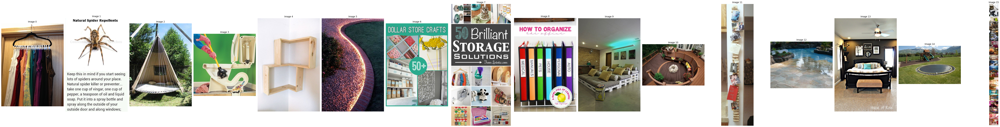

In [289]:
display_images(filtered_images, [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15])

Display ground truth

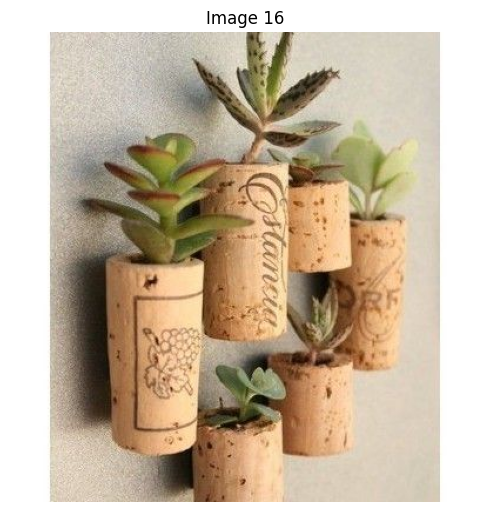

In [291]:
display_images(filtered_images, [16])

Display predictions

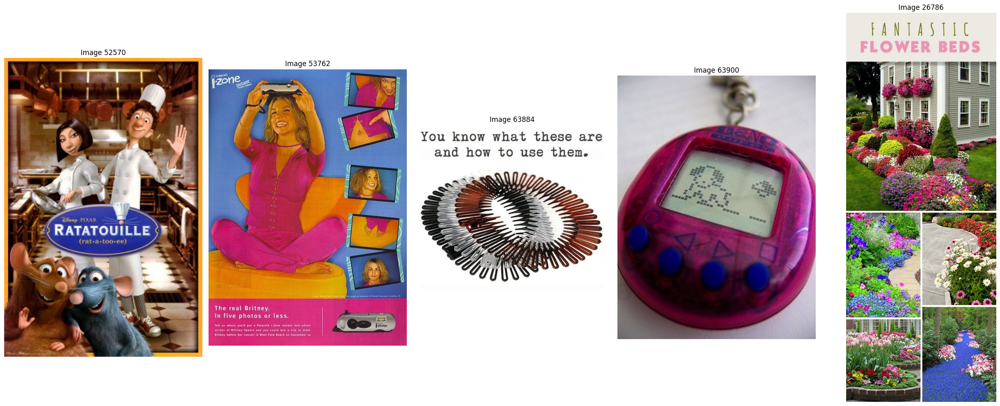

In [290]:
display_images(filtered_images, indices[0])